In [2]:
import pandas as pd
from datetime import date
from matplotlib.dates import date2num, num2date
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
import seaborn as sns

# my functions
from helper_functions import (
    check_points_inside_valid_range, get_borough_names, 
    folium_NYC, add_pickup_dropoff_markers, add_airport_locations, 
    distance_covered, airport_distance, get_date_features, 
    get_numeric_date_aft_nov_2012
)

import warnings
warnings.filterwarnings('ignore')


<table style='width:100%;'>
  <th>
    <tr>
      <th><b style='color:#13579f;font-size:22px;'>Data Fields</b></th>
      <th><b style='color:#13579f;font-size:22px;'>Description</b></th>
      <th><b style='color:#13579f;font-size:22px;'>Type</b></th>
      <th><b style='color:#13579f;font-size:22px;'>Used As</b></th>
    </tr>
  </th>
  <tbody>
    <tr>
      <td><b style='color:#236DBD;font-size:18px;'>key</b></td>
      <td><span style='color:#6399CF;'>Unique value identifying each row</span></td>
      <td><i style='color:#6399CF;'>string</i></td>
      <td><b style='color:#6399CF;'><i>ID</i></b></td>
    </tr>
    <tr>
      <td><b style='color:#236DBD;font-size:18px;'>pickup_datetime</b></td>
      <td><span style='color:#6399CF;'>Value indicating when the taxi ride started</span></td>
      <td><i style='color:#6399CF;'>timestamp</i></td>
      <td><b style='color:#6399CF;'><i>Feature</i></b></td>
    </tr>
    <tr>
      <td><b style='color:#236DBD;font-size:18px;'>pickup_longitude</b></td>
      <td><span style='color:#6399CF;'>Longitude coordinate of where the taxi ride started</span></td>
      <td><i style='color:#6399CF;'>float</i></td>
      <td><b style='color:#6399CF;'><i>Feature</i></b></td>
    </tr>
    <tr>
      <td><b style='color:#236DBD;font-size:18px;'>pickup_latitude</b></td>
      <td><span style='color:#6399CF;'>Latitude coordinate of where the taxi ride started</span></td>
      <td><i style='color:#6399CF;'>float</i></td>
      <td><b style='color:#6399CF;'><i>Feature</i></b></td>
    </tr>
    <tr>
      <td><b style='color:#236DBD;font-size:18px;'>dropoff_longitude</b></td>
      <td><span style='color:#6399CF;'>Longitude coordinate of where the taxi ride ended</span></td>
      <td><i style='color:#6399CF;'>float</i></td>
      <td><b style='color:#6399CF;'><i>Feature</i></b></td>
    </tr>
    <tr>
      <td><b style='color:#236DBD;font-size:18px;'>dropoff_latitude</b></td>
      <td><span style='color:#6399CF;'>Latitude coordinate of where the taxi ride ended</span></td>
      <td><i style='color:#6399CF;'>float</i></td>
      <td><b style='color:#6399CF;'><i>Feature</i></b></td>
    </tr>
    <tr>
      <td><b style='color:#236DBD;font-size:18px;'>passenger_count</b></td>
      <td><span style='color:#6399CF;'>Indicating the number of passengers in the taxi ride</span></td>
      <td><i style='color:#6399CF;'>integer</i></td>
      <td><b style='color:#6399CF;'><i>Feature</i></b></td>
    </tr>
    <tr>
      <td><b style='color:#236DBD;font-size:18px;'>fare_amount</b></td>
      <td><span style='color:#6399CF;'>Dollar amount of the cost of the taxi ride</span></td>
      <td><i style='color:#6399CF;'>float</i></td>
      <td><b style='color:#6399CF;'><i>Target</i></b></td>
    </tr>
</table>


<i style='color:red;'>!!! The original dataset consists of 55 million rows, which is way to much to process. so I randomly sampled 5 million rows and will use these them for training, validation and testing</i>

# Data Preprocessing and EDA

## Take a First Look

In [2]:
df = pd.read_csv("Data/NYC_Taxi_Dataset.csv", index_col=['key'])
df.drop('Unnamed: 0', axis=1, inplace=True)
df.head()

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
key,,,,,,,
2010-01-16 20:06:00.000000168,3.3,2010-01-16 20:06:00 UTC,-73.953323,40.778532,-73.953375,40.772505,1
2010-09-22 23:21:00.00000065,6.5,2010-09-22 23:21:00 UTC,-73.985542,40.738333,-74.003350,40.738935,1
2013-10-17 18:40:14.0000001,5.0,2013-10-17 18:40:14 UTC,-73.999945,40.718097,-73.999239,40.723103,1
2015-06-09 19:39:42.0000009,40.5,2015-06-09 19:39:42 UTC,-73.974533,40.756237,-73.923149,40.867210,1
2012-05-01 07:16:59.0000001,7.7,2012-05-01 07:16:59 UTC,-73.952835,40.786351,-73.974022,40.762765,1


In [3]:
df.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Index: 5000000 entries, 2010-01-16 20:06:00.000000168 to 2013-05-25 10:58:41.0000002
Data columns (total 7 columns):
 #   Column             Non-Null Count    Dtype  
---  ------             --------------    -----  
 0   fare_amount        5000000 non-null  float64
 1   pickup_datetime    5000000 non-null  object 
 2   pickup_longitude   5000000 non-null  float64
 3   pickup_latitude    5000000 non-null  float64
 4   dropoff_longitude  4999962 non-null  float64
 5   dropoff_latitude   4999962 non-null  float64
 6   passenger_count    5000000 non-null  int64  
dtypes: float64(5), int64(1), object(1)
memory usage: 305.2+ MB


<p style='color:#236DBD;'>Guess we have a few NaN values of dropoff coordinates. It won't be a problem to drop them.</p>

In [4]:
# drop rows with missing values
df.dropna(inplace=True)

## Validate Coordinates

In [13]:
df.describe()

,Unnamed: 0,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
count,4.999962e+06,4.999962e+06,4.999962e+06,4.999962e+06,4.999962e+06,4.999962e+06,4.999962e+06
mean,2.499980e+06,1.135203e+01,-7.249483e+01,3.991003e+01,-7.250288e+01,3.990991e+01,1.684918e+00
std,1.443365e+06,4.314731e+01,1.257412e+01,9.526541e+00,1.242478e+01,9.665967e+00,1.321422e+00
min,0.000000e+00,-7.500000e+01,-3.344155e+03,-3.430761e+03,-3.386063e+03,-3.430761e+03,0.000000e+00
25%,1.249990e+06,6.000000e+00,-7.399207e+01,4.073492e+01,-7.399141e+01,4.073398e+01,1.000000e+00
50%,2.499980e+06,8.500000e+00,-7.398181e+01,4.075264e+01,-7.398017e+01,4.075315e+01,1.000000e+00
75%,3.749971e+06,1.250000e+01,-7.396708e+01,4.076711e+01,-7.396366e+01,4.076809e+01,2.000000e+00
max,4.999961e+06,9.396336e+04,3.061945e+03,3.014528e+03,3.061873e+03,3.407391e+03,2.080000e+02


In [5]:
# GET BOROUGH NAMES
get_borough_names(df)

Loading borough boundaries file...
Getting pickup and dropoff coordinates...
 - Pickup
 - Dropoff
Creating GeoDataFrames with the coordinates...
 - Pickup
 - Dropoff
Performing spatial join and extract borough name...
 - Pickup
 - Dropoff
Adding borough names to df...
Done!


In [3]:
# pickup locations
df = check_points_inside_valid_range('boroughs\Around_NYC.geojson', df, 'pickup_longitude', 'pickup_latitude', 'pickup_inside')

# dropoff locations
df = check_points_inside_valid_range('boroughs\Around_NYC.geojson', df, 'dropoff_longitude', 'dropoff_latitude', 'dropoff_inside')

Creating shapely points...


  0%|          | 0/4999962 [00:00<?, ?it/s]

Checking points...


  0%|          | 0/4999962 [00:00<?, ?it/s]

Returning DataFrame...
Done!
Creating shapely points...


  0%|          | 0/4999962 [00:00<?, ?it/s]

Checking points...


  0%|          | 0/4999962 [00:00<?, ?it/s]

Returning DataFrame...
Done!


In [9]:
# Initialize a map and draw boroughs
m = folium_NYC(add_polygon=True)

# Add pickup/dropoff locations
pickup_coords = df[['pickup_latitude', 'pickup_longitude']].sample(1000, random_state=2).values.tolist()
dropoff_coords = df[['dropoff_latitude', 'dropoff_longitude']].sample(1000, random_state=2).values.tolist()
m = add_pickup_dropoff_markers(m, pickup_coords, dropoff_coords)

# Show the map
print('MARK SOME TAXI PICKUP LOCATIONS ON A MAP')
m

MARK SOME TAXI PICKUP LOCATIONS ON A MAP


<p style='color:yellow;'>Let's take care of pickup and dropoff coordinates. Valid values from latitude and longitude are <b style='color:red;'><i>(-90; 90)</i></b> and <b style='color:red;'><i>(-180; 180)</i></b>, respectively. There are values that do not fall inside these ranges.</p>

<p style='color:yellow;'>There are observation with one good coordinate inside the valid range and another that has been mistakenly recorded during data entry process.</p>

<p style='color:yellow;'>There are lats and longs equal to 0. Might be the case that these coordinates were missing and have been filled with 0. They will cause problems.</p>

<p style='color:yellow;'>NYC coordinates on map is <b style='color:red;'><i>(lat 40.730610, long -73.935242)</b></i>. Pickup/dropoff locations must be some values around them. Still, there are some values that are in latitude column but should have been in longitude and vice versa. They might have been misplaced during data entry process.</p>

<p style='color:yellow'>I hand drown polygon around NYC, which should limit coordinates around NYC. It should retain only valid coordinates. Let's keep only coordinates for which both pickup and dropoff coordinates are inside valid range. This should take care of all the problems listed above.</p>

In [25]:
misplaced = df.loc[(df.pickup_inside=='Outside') | (df.dropoff_inside=='Outside')]
print(f"Dropped {misplaced.shape[0]} misplaced observations.")

# drop invalid observations
df = df.loc[(df.pickup_inside=='Inside') & (df.dropoff_inside=='Inside')]

Dropped 111929 misplaced observations.


## Get Boroughs for each coordinate

In [43]:
print(df.pickup_boro_name.value_counts(), end='\n\n')
print(df.dropoff_boro_name.value_counts())

pickup_boro_name
Manhattan        4519217
Queens            241886
Brooklyn          108244
Outside NYC        13860
Bronx               4573
Staten Island        253
Name: count, dtype: int64

dropoff_boro_name
Manhattan        4348942
Queens            245717
Brooklyn          242169
Bronx              25223
Outside NYC        24781
Staten Island       1201
Name: count, dtype: int64


In [74]:
# Initialize a map and draw boroughs
m = folium_NYC(add_polygon=True)

# Add misplaced pickup/dropoff locations
pickup_coords = misplaced[['pickup_latitude', 'pickup_longitude']].sample(1000, random_state=42).values.tolist()
dropoff_coords = misplaced[['dropoff_latitude', 'dropoff_longitude']].sample(1000, random_state=42).values.tolist()
m = add_pickup_dropoff_markers(m, pickup_coords, dropoff_coords)

# Show the map
print('MARK MISPLACED TAXI PICKUP/DROP-OFF LOCATIONS ON A MAP')
m

MARK MISPLACED TAXI PICKUP/DROP-OFF LOCATIONS ON A MAP


<p style='color:yellow;'>I tried to mark sample of misplaced coordinates. Clearly, they are erroes made during data entry process. There are pickup/drop-off locations within NYC but out of those at least one number is not valid causing pickup location to be inside or around the city but drop-off location somewhere far away, and vice versa (click on markers to see what I'm pointing out). Zoom out the graph and You will see that there are many coordinates that are nowhere close to NYC.</p>

## Boroughs

In [51]:
# Let's split data into train/valid/test sets before we continue with preprocessing
# Since dataset is quite big we will take 2% of rows for validation and 2% for testing.
train_df, valid_df = train_test_split(df, test_size=0.04, shuffle=True, random_state=42)
valid_df, test_df = train_test_split(valid_df, test_size=0.5, shuffle=True, random_state=42)

# remove df to free up space
del df

In [49]:
print(train_df.pickup_boro_name.nunique(), train_df.dropoff_boro_name.nunique())
print(valid_df.pickup_boro_name.nunique(), valid_df.dropoff_boro_name.nunique())
print(test_df.pickup_boro_name.nunique(), test_df.dropoff_boro_name.nunique())

6 6
6 6
6 6


In [50]:
print(train_df.pickup_boro_name.value_counts(), end='\n\n')
print(train_df.dropoff_boro_name.value_counts())

pickup_boro_name
Manhattan        4338428
Queens            232154
Brooklyn          103984
Outside NYC        13313
Bronx               4393
Staten Island        239
Name: count, dtype: int64

dropoff_boro_name
Manhattan        4175024
Queens            235845
Brooklyn          232439
Bronx              24230
Outside NYC        23822
Staten Island       1151
Name: count, dtype: int64


In [73]:
# Initialize a map and draw boroughs
m = folium_NYC(add_polygon=True)

# Add misplaced pickup/dropoff locations
pickup_coords = train_df[['pickup_latitude', 'pickup_longitude']].sample(1000, random_state=42).values.tolist()
dropoff_coords = train_df[['dropoff_latitude', 'dropoff_longitude']].sample(1000, random_state=42).values.tolist()
m = add_pickup_dropoff_markers(m, pickup_coords, dropoff_coords)

# Show the map
print('MARK SAMPLE OF TAXI PICKUP/DROP-OFF LOCATIONS ON A MAP')
m

MARK SAMPLE OF TAXI PICKUP/DROP-OFF LOCATIONS ON A MAP


<p style='color:yellow;'>Well, coordinates look good. Also, we can see that most of the taxi rides took place in Manhattan.</p>

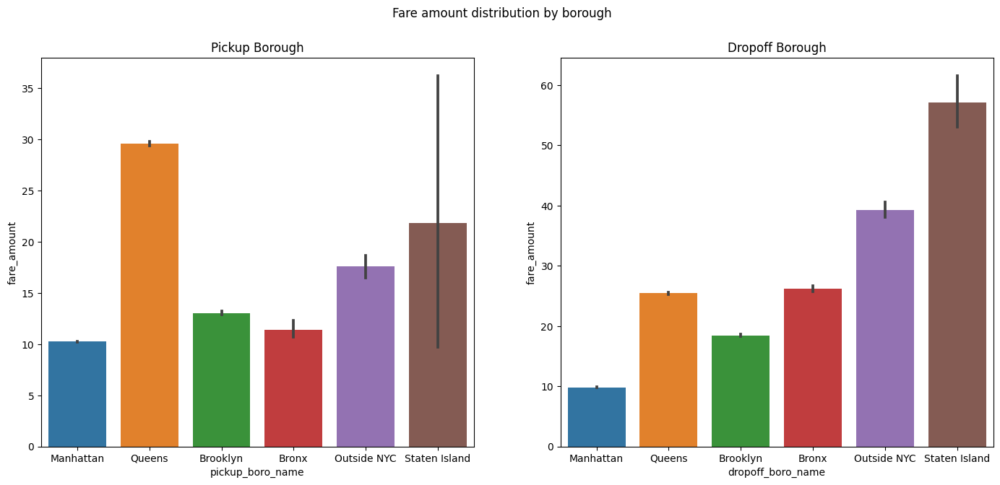

In [53]:
fig, axes = plt.subplots(1, 2, figsize=(17,7))
fig.suptitle('Fare amount distribution by borough')

sns.barplot(data=train_df.sample(500000, random_state=42), x='pickup_boro_name', y='fare_amount', ax=axes[0])
axes[0].set_title('Pickup Borough')

sns.barplot(data=train_df.sample(500000, random_state=42), x='dropoff_boro_name', y='fare_amount', ax=axes[1])
axes[1].set_title('Dropoff Borough')

plt.show();

In [54]:
# Let's get dummies for pickup and dropoff boroughs to use them in analysis.
dummies1 = pd.get_dummies(train_df['pickup_boro_name'], drop_first=True, prefix='pickup').astype('int')
dummies2 = pd.get_dummies(train_df['dropoff_boro_name'], drop_first=True, prefix='dropoff').astype('int')
train_df = pd.concat([train_df, dummies1, dummies2], axis=1)

dummies1 = pd.get_dummies(valid_df['pickup_boro_name'], drop_first=True, prefix='pickup').astype('int')
dummies2 = pd.get_dummies(valid_df['dropoff_boro_name'], drop_first=True, prefix='dropoff').astype('int')
valid_df = pd.concat([valid_df, dummies1, dummies2], axis=1)

dummies1 = pd.get_dummies(test_df['pickup_boro_name'], drop_first=True, prefix='pickup').astype('int')
dummies2 = pd.get_dummies(test_df['dropoff_boro_name'], drop_first=True, prefix='dropoff').astype('int')
test_df = pd.concat([test_df, dummies1, dummies2], axis=1)

# free up space
del dummies1
del dummies2

#### Ride Direction

<p style='color:yellow;'>Now let's take a look at ride direction. We can check if the ride took in the same borough, or between boroughs, or went outside the city, or went inside the city. Let's check if it affects fare amount.</p>

In [55]:
# Create column that tracks whether a ride takes place in the same borough or between boroughs or goes outside the city
train_df['direction'] = train_df.pickup_boro_name + '_' + train_df.dropoff_boro_name
valid_df['direction'] = valid_df.pickup_boro_name + '_' + valid_df.dropoff_boro_name
test_df['direction'] = test_df.pickup_boro_name + '_' + test_df.dropoff_boro_name

In [56]:
train_df.direction.value_counts()

direction
Manhattan_Manhattan            4003460
Manhattan_Queens                157249
Manhattan_Brooklyn              146734
Queens_Manhattan                129364
Queens_Queens                    71851
Brooklyn_Brooklyn                59865
Brooklyn_Manhattan               37541
Queens_Brooklyn                  25359
Manhattan_Bronx                  17704
Manhattan_Outside NYC            12621
Outside NYC_Outside NYC           8506
Brooklyn_Queens                   5996
Outside NYC_Manhattan             3559
Queens_Bronx                      3185
Bronx_Bronx                       3018
Queens_Outside NYC                2185
Bronx_Manhattan                   1088
Manhattan_Staten Island            660
Outside NYC_Queens                 636
Outside NYC_Brooklyn               446
Brooklyn_Outside NYC               340
Queens_Staten Island               210
Staten Island_Staten Island        196
Brooklyn_Bronx                     185
Bronx_Outside NYC                  144
Outside NYC_Bro

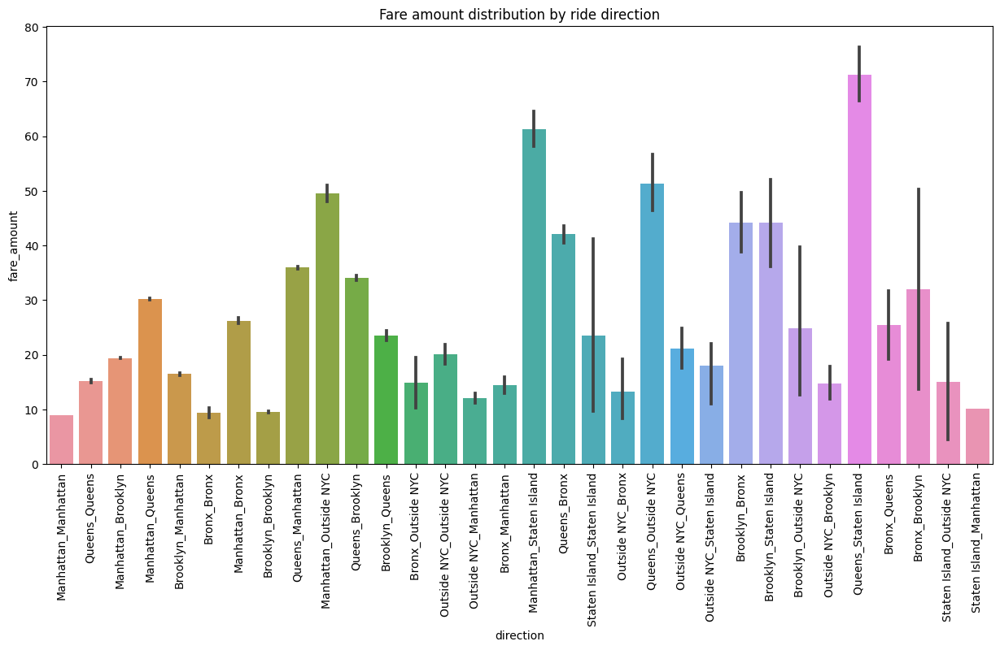

In [57]:
fig = plt.subplots(figsize=(15,7))

plt.title('Fare amount distribution by ride direction')
fig = sns.barplot(data=train_df.sample(500000, random_state=42), x='direction', y='fare_amount')
plt.xticks(rotation=90)
plt.show();

#### Distance Covered During a Ride

In [58]:
distance_covered(train_df, 'train_df')
distance_covered(valid_df, 'valid_df')
distance_covered(test_df, 'test_df')

Calculating distance covered for "train_df"...
Converting latitude and longitude from degrees to radians...
Mesuring distance...
Adding "distance_covered" to train_df...
Done!

Calculating distance covered for "valid_df"...
Converting latitude and longitude from degrees to radians...
Mesuring distance...
Adding "distance_covered" to valid_df...
Done!

Calculating distance covered for "test_df"...
Converting latitude and longitude from degrees to radians...
Mesuring distance...
Adding "distance_covered" to test_df...
Done!



In [59]:
train_df.distance_covered.sort_values().head(90000)

key
2009-04-06 17:50:00.00000069     0.000000
2009-07-03 04:10:00.00000035     0.000000
2013-02-19 18:48:00.000000250    0.000000
2011-08-19 20:03:00.000000252    0.000000
2012-09-05 17:58:00.000000102    0.000000
                                   ...   
2009-08-15 13:58:49.0000001      0.204201
2013-03-25 19:36:00.00000036     0.204210
2011-06-27 22:25:00.00000042     0.204220
2012-12-04 22:24:00.000000207    0.204226
2013-07-13 23:58:00.00000086     0.204230
Name: distance_covered, Length: 90000, dtype: float64

<p style='color:yellow;'>Well, we might still be suffering from data enrty problems. there are quite a lot of values <b style='color:red;'>(about 85K-90K) with distance 0</b>. It could be caused by having only one location available for both puckup and dropoff places. Also, I'm planning to drop values that are <b style='color:red;'>below 200m meters</b>, because taking taxi for shorter distances does not make sense. So let's go ahead and drop them.</p>

In [60]:
train_df = train_df.loc[train_df.distance_covered>0.2]

In [61]:
train_df.distance_covered.sort_values()

key
2009-02-07 00:51:00.000000173     0.200005
2015-03-18 08:03:31.0000004       0.200008
2010-05-26 12:13:08.0000004       0.200012
2011-09-09 13:02:14.0000001       0.200017
2014-04-10 07:59:00.00000092      0.200025
                                   ...    
2014-06-05 20:36:00.00000038     42.310428
2013-10-09 23:38:00.00000099     42.893971
2012-06-09 19:08:00.00000057     43.002805
2009-01-15 19:35:53.0000007      43.862099
2012-10-17 12:53:00.000000201    54.937464
Name: distance_covered, Length: 4603180, dtype: float64

<p style='color:yellow;'>Now, both shortest and longest distance values make sense.</p>

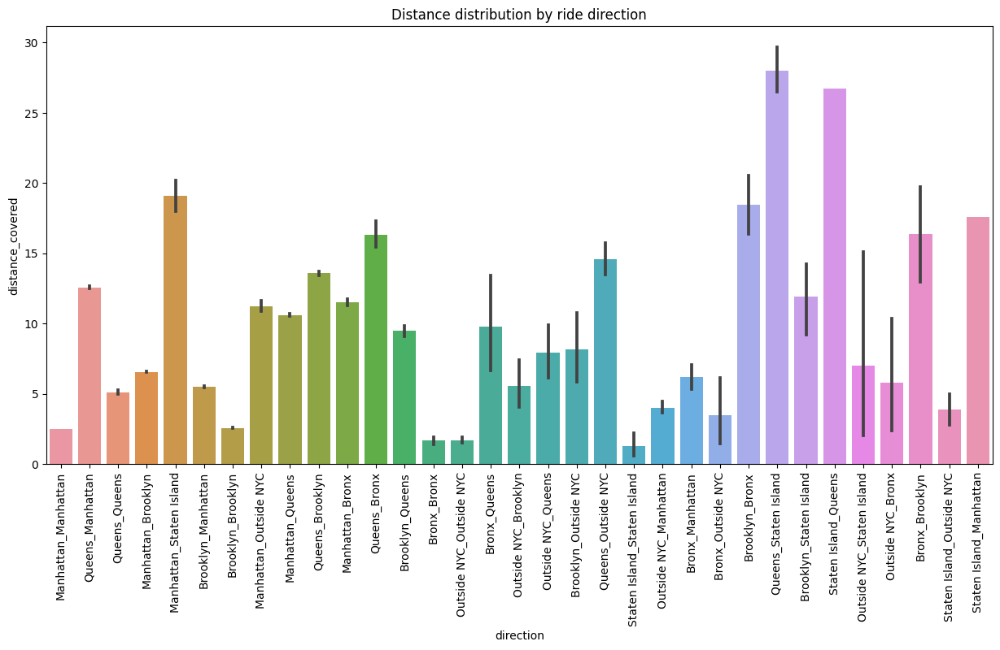

In [64]:
fig = plt.subplots(figsize=(15,7))

plt.title('Distance distribution by ride direction')
fig = sns.barplot(data=train_df.sample(500000, random_state=42), x='direction', y='distance_covered')
plt.xticks(rotation=90)
plt.show();

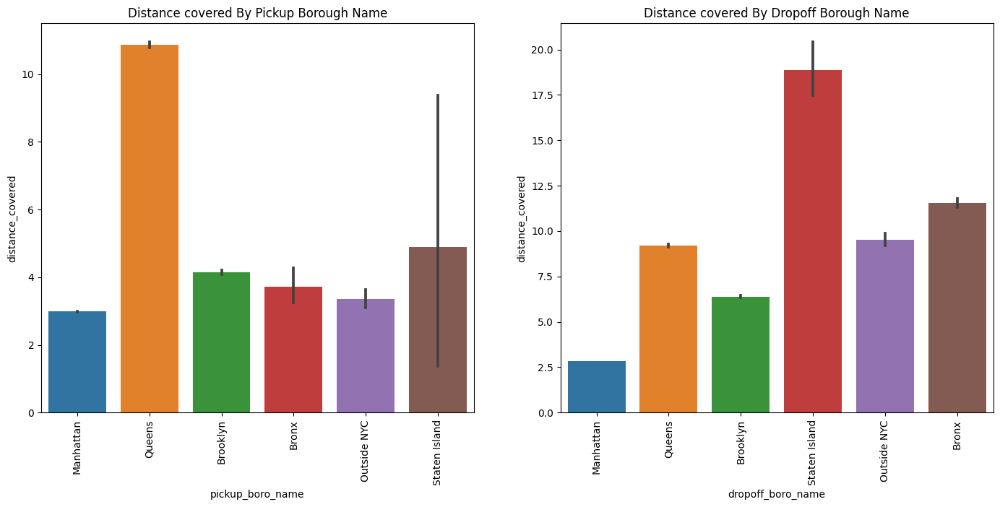

In [62]:
fig, axes = plt.subplots(1, 2, figsize=(17, 7))

sns.barplot(data=train_df.sample(500000, random_state=42), x='pickup_boro_name', y='distance_covered', ax=axes[0])
axes[0].set_title('Distance covered By Pickup Borough Name')
axes[0].tick_params(axis='x', rotation=90)

sns.barplot(data=train_df.sample(500000, random_state=42), x='dropoff_boro_name', y='distance_covered', ax=axes[1])
axes[1].set_title('Distance covered By Dropoff Borough Name')
axes[1].tick_params(axis='x', rotation=90)

plt.subplots_adjust(hspace=0.95)
plt.show();

#### Distance to airports

<p style='color:yellow;'>John F. Kennedy International Airport (JFK), LaGuardia Airport (LGA) and Newark Airports are three primary airports serving the New York City area. Since, fare might be different for traveling from/to airports let's try to find if the taxi was taken from/to airport or not.</p>

In [65]:
# Calculate haversine distance from airport to pickup/dropoff locations
airport_distance(train_df, 'train_df', 'JFK')
airport_distance(valid_df, 'valid_df', 'JFK')
airport_distance(test_df, 'test_df', 'JFK')

airport_distance(train_df, 'train_df', 'La Guardia')
airport_distance(valid_df, 'valid_df', 'La Guardia')
airport_distance(test_df, 'test_df', 'La Guardia')

airport_distance(train_df, 'train_df', 'Newark')
airport_distance(valid_df, 'valid_df', 'Newark')
airport_distance(test_df, 'test_df', 'Newark')

Calculating distance to "JFK" for "train_df"...
Converting latitude and longitude from degrees to radians...
Measuring distance between pickup location and "JFK"...
Measuring distance between dropoff location and "JFK"...
Adding "pickup_JFK_distance" to train_df...
Adding "dropoff_JFK_distance" to train_df...
Done!

Calculating distance to "JFK" for "valid_df"...
Converting latitude and longitude from degrees to radians...
Measuring distance between pickup location and "JFK"...
Measuring distance between dropoff location and "JFK"...
Adding "pickup_JFK_distance" to valid_df...
Adding "dropoff_JFK_distance" to valid_df...
Done!

Calculating distance to "JFK" for "test_df"...
Converting latitude and longitude from degrees to radians...
Measuring distance between pickup location and "JFK"...
Measuring distance between dropoff location and "JFK"...
Adding "pickup_JFK_distance" to test_df...
Adding "dropoff_JFK_distance" to test_df...
Done!

Calculating distance to "La Guardia" for "train_d

In [69]:
# Find out what was the closest distance to airport and save it
train_df['distance_to_airport'] = train_df.iloc[:, -6:].min(axis=1)
valid_df['distance_to_airport'] = valid_df.iloc[:, -6:].min(axis=1)
test_df['distance_to_airport'] = test_df.iloc[:, -6:].min(axis=1)

# Save to or from which airport was this distance.
# If it has pickup it means taxi was taken from airport
# If it has dropoff it means taxi was taken to airpirt
train_df['to_or_from_airport'] = train_df.iloc[:, -7:-1].idxmin(axis=1)
valid_df['to_or_from_airport'] = valid_df.iloc[:, -7:-1].idxmin(axis=1)
test_df['to_or_from_airport'] = test_df.iloc[:, -7:-1].idxmin(axis=1)

In [76]:
# Take sample around each airport
air_df1 = train_df.loc[train_df.to_or_from_airport=='pickup_La Guardia_distance'].sort_values(by='distance_to_airport').head()
air_df2 = train_df.loc[train_df.to_or_from_airport=='dropoff_La Guardia_distance'].sort_values(by='distance_to_airport').head()
air_df3 = train_df.loc[train_df.to_or_from_airport=='pickup_Newark_distance'].sort_values(by='distance_to_airport').head()
air_df4 = train_df.loc[train_df.to_or_from_airport=='dropoff_Newark_distance'].sort_values(by='distance_to_airport').head()
air_df5 = train_df.loc[train_df.to_or_from_airport=='pickup_JFK_distance'].sort_values(by='distance_to_airport').head()
air_df6 = train_df.loc[train_df.to_or_from_airport=='dropoff_JFK_distance'].sort_values(by='distance_to_airport').head()

# Stack these samples
stacked_airport_dfs = pd.concat([air_df1, air_df2, air_df3, air_df4, air_df5, air_df6], axis=0)

# Get coordinates that will be plotted inside lists
pickup_coords = []
dropoff_coords = []

for idx in stacked_airport_dfs.index.to_list():
    if 'pickup' in stacked_airport_dfs.loc[idx, 'to_or_from_airport']:
        coord = [
            stacked_airport_dfs.loc[idx, 'pickup_latitude'],
            stacked_airport_dfs.loc[idx, 'pickup_longitude']
        ]
        pickup_coords.append(coord)
    else:
        coord = [
            stacked_airport_dfs.loc[idx, 'dropoff_latitude'],
            stacked_airport_dfs.loc[idx, 'dropoff_longitude']
        ]
        dropoff_coords.append(coord)

In [78]:
# Initialize a map and draw boroughs
m = folium_NYC(add_polygon=True)

# Add airports and pickup/dropoff locations around them
m = add_pickup_dropoff_markers(m, pickup_coords, dropoff_coords)
m = add_airport_locations(m)

# Show the map
print('MARK SAMPLE OF TAXI PICKUP/DROP-OFF LOCATIONS AROUND AIRPORTS ON A MAP')
m

MARK SAMPLE OF TAXI PICKUP/DROP-OFF LOCATIONS AROUND AIRPORTS ON A MAP


In [79]:
train_df.distance_to_airport.sort_values()

key
2015-04-15 20:39:59.0000007       0.003980
2013-06-04 11:43:41.0000003       0.004149
2011-04-12 13:22:18.0000002       0.005336
2013-03-20 04:56:57.0000001       0.005413
2012-05-03 11:06:00.000000142     0.005985
                                   ...    
2013-03-28 23:19:00.00000069     27.071101
2011-06-07 21:30:00.000000207    27.082011
2012-02-23 23:15:00.000000134    27.899196
2012-03-04 13:24:00.000000200    28.786331
2012-02-22 13:53:00.000000208    29.865388
Name: distance_to_airport, Length: 4603180, dtype: float64

In [80]:
# Drop columns that we don't need anymore
train_df.drop([
    'pickup_boro_name', 'dropoff_boro_name', 'direction',
    'pickup_JFK_distance', 'dropoff_JFK_distance',
    'pickup_La Guardia_distance', 'dropoff_La Guardia_distance',
    'pickup_Newark_distance', 'dropoff_Newark_distance',
    'to_or_from_airport'], axis=1, inplace=True)

valid_df.drop([
    'pickup_boro_name', 'dropoff_boro_name', 'direction',
    'pickup_JFK_distance', 'dropoff_JFK_distance',
    'pickup_La Guardia_distance', 'dropoff_La Guardia_distance',
    'pickup_Newark_distance', 'dropoff_Newark_distance',
    'to_or_from_airport'], axis=1, inplace=True)

test_df.drop([
    'pickup_boro_name', 'dropoff_boro_name', 'direction',
    'pickup_JFK_distance', 'dropoff_JFK_distance',
    'pickup_La Guardia_distance', 'dropoff_La Guardia_distance',
    'pickup_Newark_distance', 'dropoff_Newark_distance',
    'to_or_from_airport'], axis=1, inplace=True)

#### Fare Amount

<p style='color:yellow;'>Now, let's get to <i>fare_amount</i>. First of all, let's keep fare above 0 becasue I can't imagine paying nothing or even better, getting paid for taking a taxi. Well, there is a possibility that fare might be negative because it was a refund or also could very well be typo. Moreover, there is only a few of such observations in millions of training values, therefore, we can get rid of them.</p>

In [81]:
print(f'Only {train_df.loc[train_df.fare_amount<=0].shape[0]} observations are below or equal to zero.')

Only 160 observations are below or equal to zero.


In [82]:
# keep values above 0
train_df = train_df.loc[train_df.fare_amount>0]
valid_df = valid_df.loc[valid_df.fare_amount>0]
test_df = test_df.loc[test_df.fare_amount>0]

In [83]:
train_df[['distance_covered', 'fare_amount']].sort_values(by='fare_amount').tail(20)

,distance_covered,fare_amount
key,,
2014-06-11 08:10:45.0000001,15.982044,176.00
2015-05-13 11:36:28.0000001,33.487579,178.29
2014-10-31 16:56:00.00000039,22.707200,181.83
2015-02-20 13:52:40.0000002,37.295948,185.00
2012-04-26 17:24:43.0000004,8.243145,190.00
2014-06-05 20:36:00.00000038,42.310428,191.33
2015-03-19 11:09:55.0000001,4.417482,192.66
2009-08-04 15:32:20.0000003,2.986091,195.00
2010-09-02 15:59:00.000000142,3.327914,200.00


<p style='color:yellow;'>Last two rows look way off. Let's get rid of them.</p>

In [88]:
train_df.drop(['2010-03-21 10:03:32.0000004', '2015-02-24 08:57:37.0000004'], inplace=True)

#### Passenger Count

In [91]:
train_df.passenger_count.value_counts()

passenger_count
1    3181035
2     680665
5     326041
3     203175
4      98170
6      97428
0      16500
7          3
9          1
Name: count, dtype: int64

<p style='color:yellow;'>There are some rides with zero passenger, which could be delivery service. On the other hand, minivans and big taxis could take maximum of 6-7 passengers. There are some manufacturers that offer 8-9 seat minivans but because there are only a few rides with 7 or more passengers we can go ahead and drop them.</p>

In [92]:
train_df = train_df.loc[train_df.passenger_count<7]
valid_df = valid_df.loc[valid_df.passenger_count<7]
test_df = test_df.loc[test_df.passenger_count<7]

#### Pickup Datetime

<p style='color:yellow;'>Let's extract and examine some features in <i>pickup_datetime</i>.</p>

In [93]:
get_date_features(train_df, 'train_df')
get_date_features(valid_df, 'valid_df')
get_date_features(test_df, 'test_df')

Etracting features from "train_df"...
Converting "pickup_datetime" from string to datetime...
Done!
Extracting "date"...
Done!
Extracting "year"...
Done!
Extracting "month"...
Done!
Extracting "week of a year"...
Done!
Extracting "day of a month"...
Done!
Extracting "day of a week"...
Done!
Extracting "hour of a day"...
Done!

Etracting features from "valid_df"...
Converting "pickup_datetime" from string to datetime...
Done!
Extracting "date"...
Done!
Extracting "year"...
Done!
Extracting "month"...
Done!
Extracting "week of a year"...
Done!
Extracting "day of a month"...
Done!
Extracting "day of a week"...
Done!
Extracting "hour of a day"...
Done!

Etracting features from "test_df"...
Converting "pickup_datetime" from string to datetime...
Done!
Extracting "date"...
Done!
Extracting "year"...
Done!
Extracting "month"...
Done!
Extracting "week of a year"...
Done!
Extracting "day of a month"...
Done!
Extracting "day of a week"...
Done!
Extracting "hour of a day"...
Done!



In [94]:
# aggregate fare amount by date
mean_fare_by_date = pd.DataFrame(train_df.groupby('date')['fare_amount'].mean())
mean_fare_by_date = mean_fare_by_date.reset_index()

# split data: before and after November of 2012
data_before_2012 = mean_fare_by_date.loc[mean_fare_by_date['date'] <= date(2012, 9, 3)]
data_after_2012 = mean_fare_by_date.loc[mean_fare_by_date['date'] > date(2012, 9, 3)]

# Convert dates to numeric format
data_before_2012['Date'] = data_before_2012['date'].apply(date2num)
data_after_2012['Date'] = data_after_2012['date'].apply(date2num)

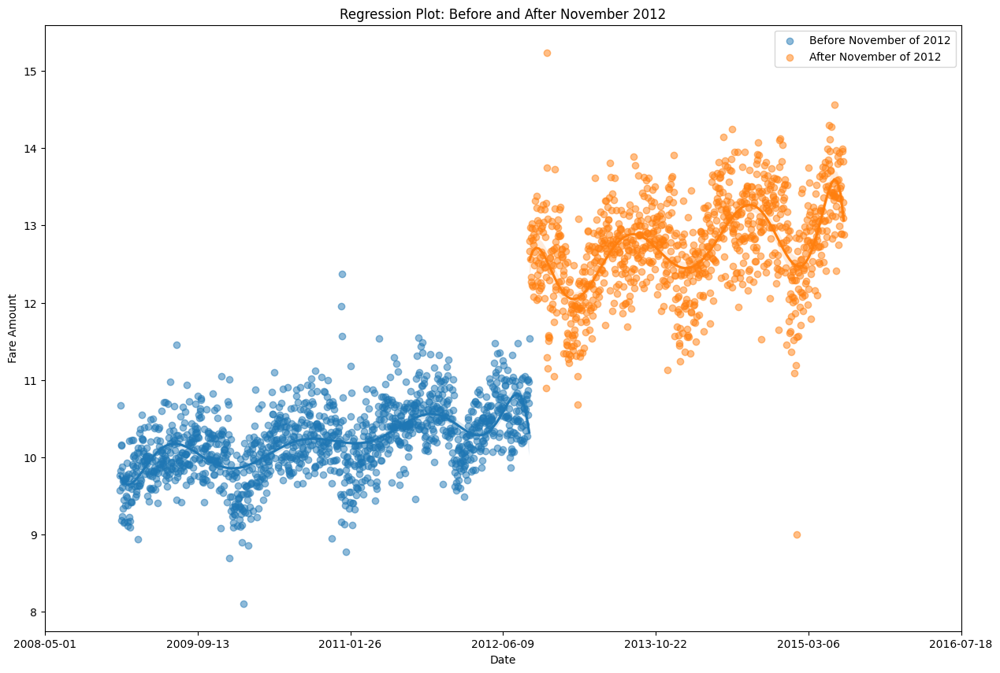

In [95]:
# Define feagure and add two plots before and after  of 2012
fig = plt.figure(figsize=(15, 10))
fig = sns.regplot(x='Date', y='fare_amount', data=data_before_2012, scatter_kws={'alpha': 0.5}, label='Before November of 2012', order=35)
fig = sns.regplot(x='Date', y='fare_amount', data=data_after_2012, scatter_kws={'alpha': 0.5}, label='After November of 2012', order=35)

# Convert x-tick values back to dates
x_ticks = plt.xticks()[0]
x_ticks_dates = [num2date(x) for x in x_ticks]
x_ticks_labels = [x.strftime('%Y-%m-%d') for x in x_ticks_dates]

# Set the x-tick labels
plt.xticks(x_ticks, x_ticks_labels)

# Set labels and title
plt.xlabel('Date')
plt.ylabel('Fare Amount')
plt.title('Regression Plot: Before and After November 2012')

# add legend
plt.legend()

# show figure
plt.show();

<p style='color:#ffb612;'>After aggregating averaging fare amount for each day we got the above graph. We can see that in November of 2012 there is an upper jump in taxi fare amount. Now, there could be many resons for this sudden jump such as fuel prices, demand-supply dynamics, and economic conditions. Furthermore, in September 2012, there were significant changes in the transportation industry in New York City that could have influenced taxi prices. One notable change during that period was the implementation of the Taxi and Limousine Commission's (TLC) "Taxi of Tomorrow" program.</p>
<p style='color:#ffb612;'>This is how this change could influence taxi fare:</p>
<ul style='color:yellow;'>"Taxi of Tomorrow" program was aimed to replace the existing mix of vehicles with a single, purpose-built taxi model, the Nissan NV200. The new taxi model offered enhanced features, such as improved legroom, passenger amenities, and safety features.</ul>
<ul style='color:yellow;'>Older taxis were required to be retired from service. This retirement plan aimed to modernize the taxi fleet and improve passenger experience and safety. The retirement of older, potentially less fuel-efficient vehicles could have increased operational costs for taxi owners and potentially influenced fare prices.</ul>
<ul style='color:yellow;'>The transition to the new taxi model and the mandatory retirement of older taxis involved costs for taxi owners. The purchase or lease of the new vehicles, as well as retrofitting existing taxis to meet the new regulations, could have increased the financial burden on taxi owners. To compensate for these costs, taxi fares might have been adjusted.</ul>
<ul style='color:yellow;'>The program also introduced technological advancements and improved passenger amenities, such as a panoramic sunroof, USB charging ports, and a passenger-controlled rear-seat climate control system. These enhancements might have been considered as additional value provided by taxi services, potentially influencing fare prices.</ul>
<p style='color:#ffb612;'>Let's convert date into numeric date to use it in analysis. Also, to indicate that there is a significant upper jump in taxi prices after November of 2012, let's denote the period before November of 2012 with 0 and the period after it with 1.</p>

In [96]:
get_numeric_date_aft_nov_2012(train_df, 'train_df')
get_numeric_date_aft_nov_2012(valid_df, 'valid_df')
get_numeric_date_aft_nov_2012(test_df, 'test_df')

Working On DataFrame: "train_df"
Converting "date" to numeric and adding to "numeric_date" column...
Done!
Adding "after_nov_2012" colum...
Done!

Working On DataFrame: "valid_df"
Converting "date" to numeric and adding to "numeric_date" column...
Done!
Adding "after_nov_2012" colum...
Done!

Working On DataFrame: "test_df"
Converting "date" to numeric and adding to "numeric_date" column...
Done!
Adding "after_nov_2012" colum...
Done!



---

In [117]:
# aggregate fare amount by year
mean_fare_by_year = pd.DataFrame(train_df.groupby('year')['fare_amount'].mean())
mean_fare_by_year = mean_fare_by_year.reset_index()

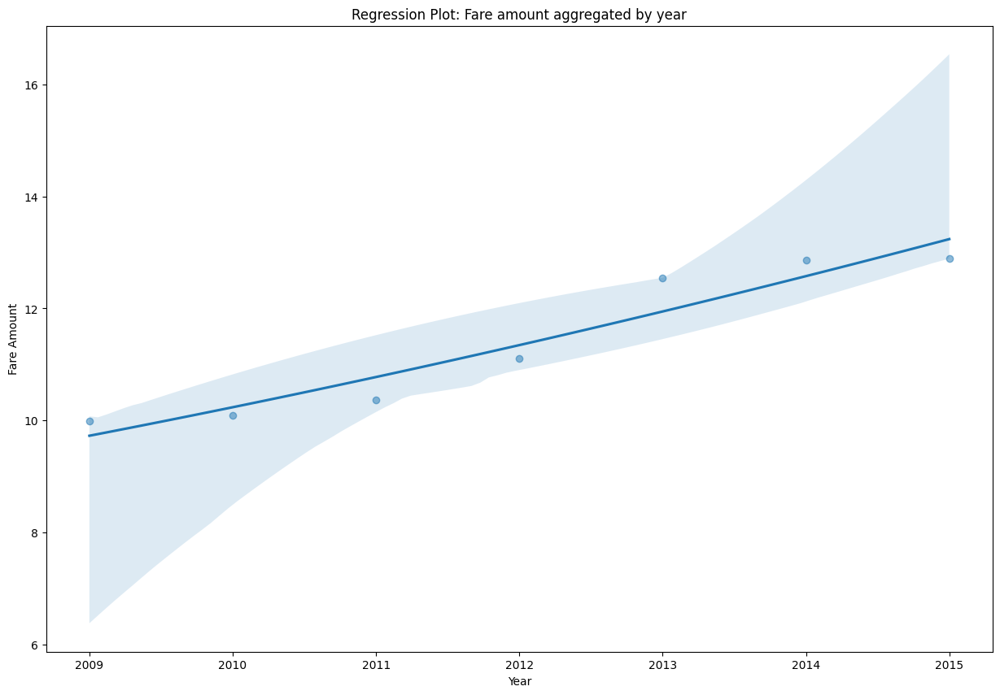

In [118]:
fig = plt.figure(figsize=(15, 10))
fig = sns.regplot(x='year', y='fare_amount', data=mean_fare_by_year, scatter_kws={'alpha': 0.5}, order=2)

# Set labels and title
plt.xlabel('Year')
plt.ylabel('Fare Amount')
plt.title('Regression Plot: Fare amount aggregated by year')

# show figure
plt.show();

---

In [119]:
# aggregate fare amount by month
mean_fare_by_month = pd.DataFrame(train_df.groupby('month')['fare_amount'].mean())
mean_fare_by_month = mean_fare_by_month.reset_index()

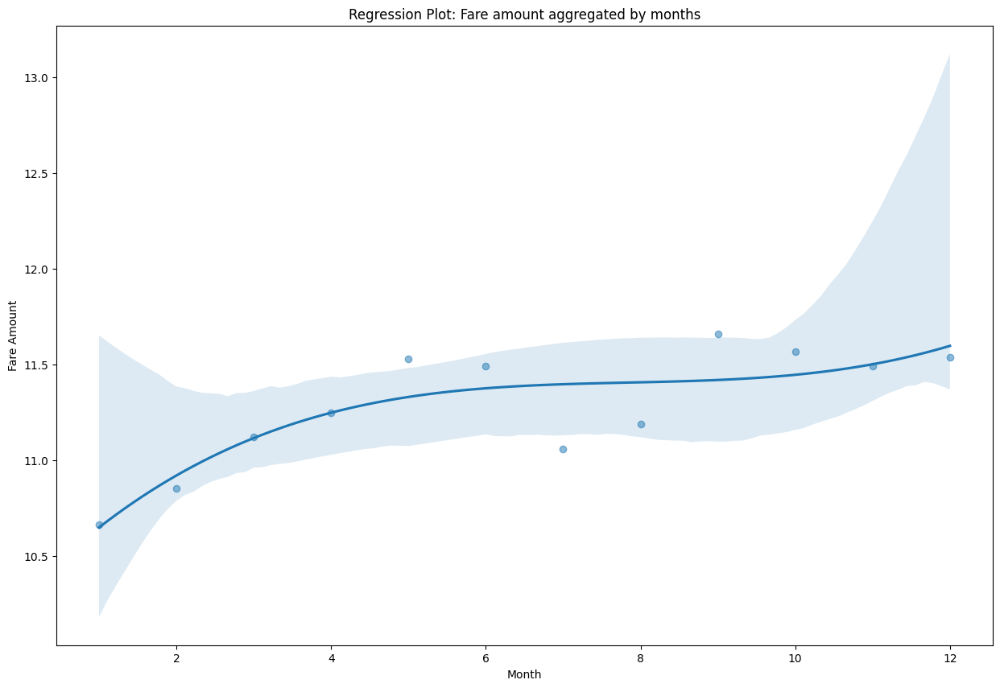

In [120]:
fig = plt.figure(figsize=(15, 10))
fig = sns.regplot(x='month', y='fare_amount', data=mean_fare_by_month, scatter_kws={'alpha': 0.5}, order=3)

# Set labels and title
plt.xlabel('Month')
plt.ylabel('Fare Amount')
plt.title('Regression Plot: Fare amount aggregated by months')

# show figure
plt.show();

---

In [121]:
# aggregate fare amount by week
mean_fare_by_week = pd.DataFrame(train_df.groupby('week')['fare_amount'].mean())
mean_fare_by_week = mean_fare_by_week.reset_index()

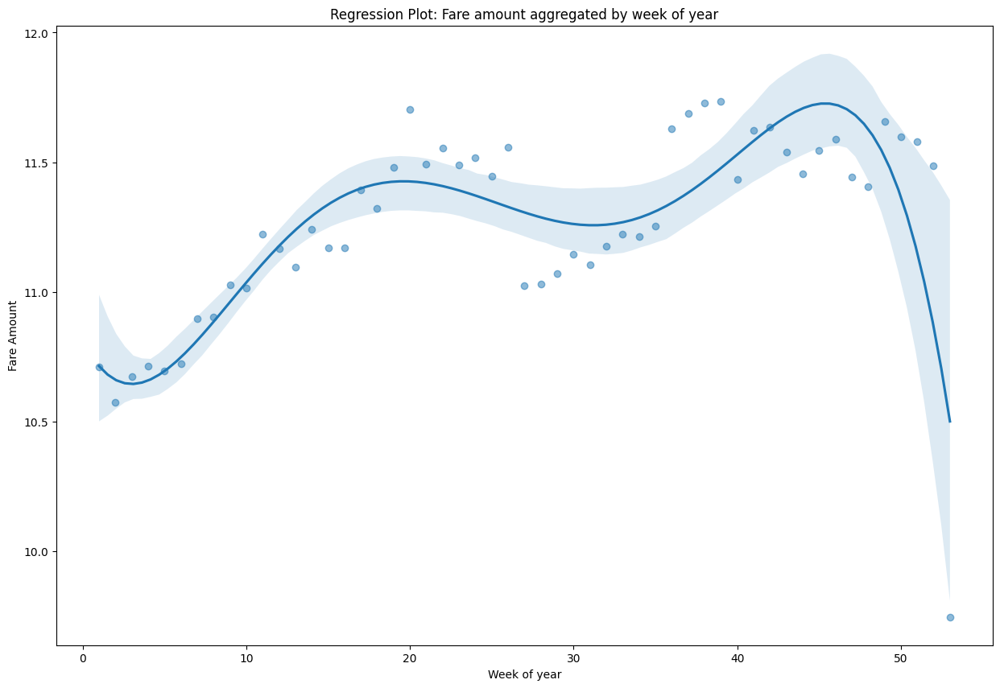

In [122]:
fig = plt.figure(figsize=(15, 10))
fig = sns.regplot(x='week', y='fare_amount', data=mean_fare_by_week, scatter_kws={'alpha': 0.5}, order=5)

# Set labels and title
plt.xlabel('Week of year')
plt.ylabel('Fare Amount')
plt.title('Regression Plot: Fare amount aggregated by week of year')

# show figure
plt.show();

---

In [123]:
# aggregate fare amount by day of month
mean_fare_by_day = pd.DataFrame(train_df.groupby('day_of_month')['fare_amount'].mean())
mean_fare_by_day = mean_fare_by_day.reset_index()

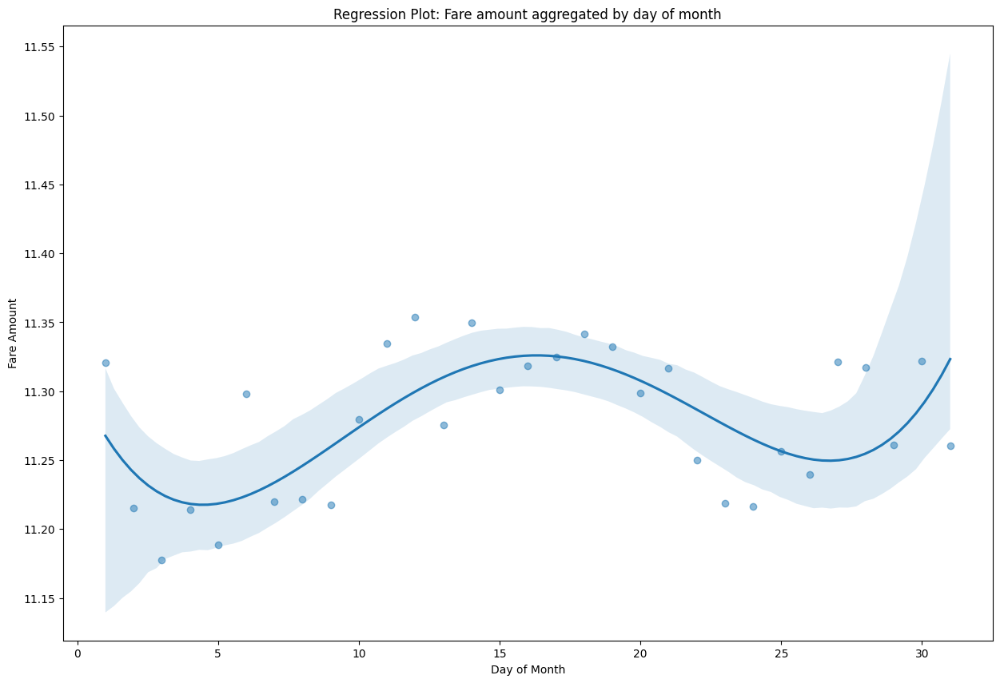

In [124]:
fig = plt.figure(figsize=(15, 10))
fig = sns.regplot(x='day_of_month', y='fare_amount', data=mean_fare_by_day, scatter_kws={'alpha': 0.5}, order=4)

# Set labels and title
plt.xlabel('Day of Month')
plt.ylabel('Fare Amount')
plt.title('Regression Plot: Fare amount aggregated by day of month')

# show figure
plt.show();

---

In [125]:
# aggregate fare amount by day of week
mean_fare_by_day = pd.DataFrame(train_df.groupby('day_of_week')['fare_amount'].mean())
mean_fare_by_day = mean_fare_by_day.reset_index()

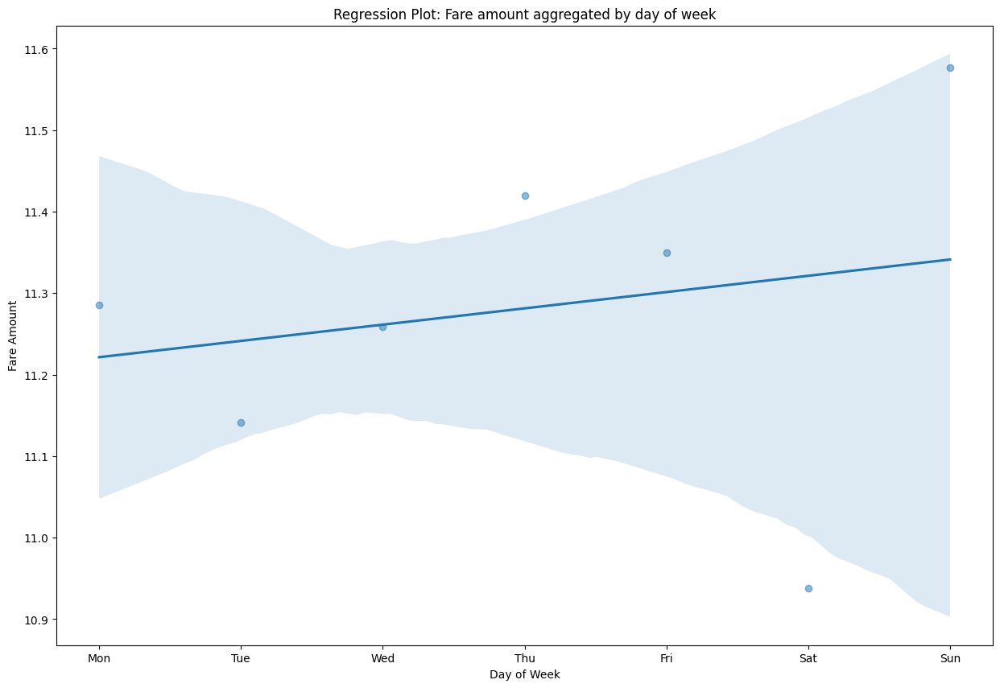

In [129]:
fig = plt.figure(figsize=(15, 10))
fig = sns.regplot(x='day_of_week', y='fare_amount', data=mean_fare_by_day, scatter_kws={'alpha': 0.5}, order=1)
plt.xticks(range(0,7), ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'])
# Set labels and title
plt.xlabel('Day of Week')
plt.ylabel('Fare Amount')
plt.title('Regression Plot: Fare amount aggregated by day of week')

# show figure
plt.show();

---

In [130]:
# aggregate fare amount by hour
mean_fare_by_hour = pd.DataFrame(train_df.groupby('hour')['fare_amount'].mean())
mean_fare_by_hour = mean_fare_by_hour.reset_index()

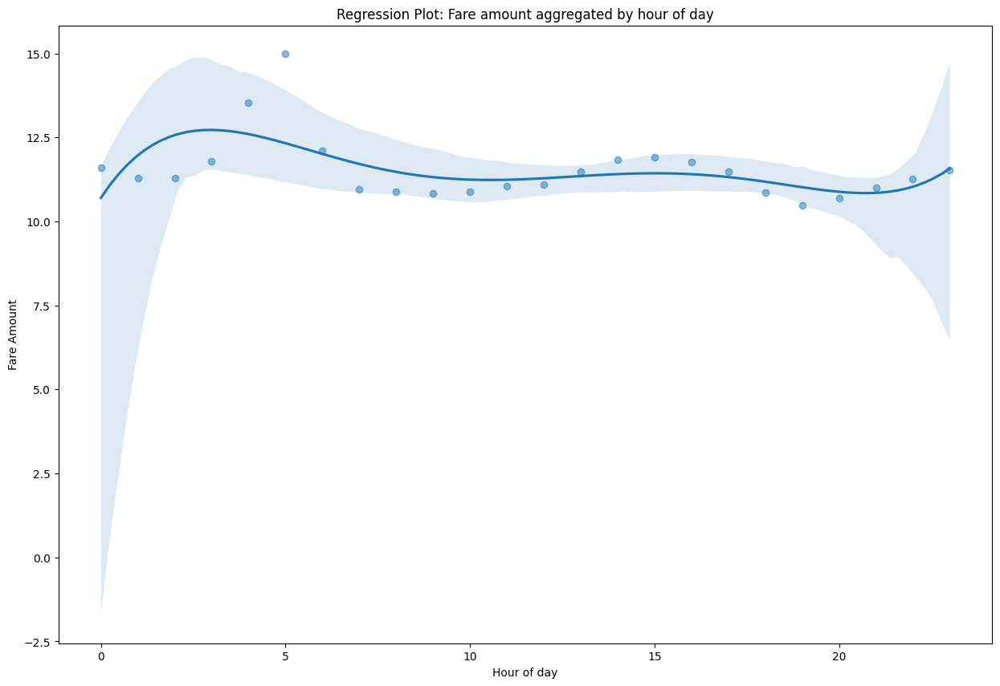

In [136]:
fig = plt.figure(figsize=(15, 10))
fig = sns.regplot(x='hour', y='fare_amount', data=mean_fare_by_hour, scatter_kws={'alpha': 0.5}, order=5)

# Set labels and title
plt.xlabel('Hour of day')
plt.ylabel('Fare Amount')
plt.title('Regression Plot: Fare amount aggregated by hour of day')

# show figure
plt.show();

<p style='color:yellow;'>Well the model should identify those trends and seasonalities therfore, I'm  going to include these time features in out analysis even thought it is not exactly time series model.</p>

#### Save Final Train/Valid/Test

In [141]:
train_df.shape, test_df.shape, valid_df.shape

((4603014, 30), (97752, 30), (97756, 30))

In [145]:
### Let's first drop unnacessary columns
train_df = train_df.drop(['pickup_datetime', 'pickup_inside', 'dropoff_inside', 'date'], axis=1)

valid_df = valid_df.drop(['pickup_datetime', 'pickup_inside', 'dropoff_inside', 'date'], axis=1)

test_df = test_df.drop(['pickup_datetime', 'pickup_inside', 'dropoff_inside', 'date'], axis=1)

In [144]:
# Save Dataframes for training
train_df.to_csv('Data/train_df.csv')
valid_df.to_csv('Data/valid_df.csv')
test_df.to_csv('Data/test_df.csv')